<a href="https://colab.research.google.com/github/TheSeems/PAMiSE/blob/main/PAMiSE_Team3_HW2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preparations

## Mount the drive where all the data is located at

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Path to the folder inside which all the data is located
# Relative to the root of the mounted Google Drive
DRIVE_PATH = 'drive/MyDrive/Team_3_PAMiSE'

## Installing necessary dependencies

In [ ]:
!pip install pm4py==2.7.8.1 elementpath

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.4/216.4 kB 16.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Created wheel for intervaltree: filename=intervaltree-3.1.0-py2.py3-none-any.whl size=26095 sha256=6fbd46c2850c88261334e0008f110e3264bb6ededf8c202a94d5e68b0697dc1b
  Stored in directory: /root/.cache/pip/wheels/fa/80/8c/43488a924a046b733b64de3fac99252674c892a4c3801c0a61
  Created wheel for stringdist: filename=StringDist-1.0.9-cp310-cp310-linux_x86_64.whl size=16967 sha256=4599b32e8b296c3aa1e94300e4063127b8cd9def5308f70f93c9335d2df1985b
  Stored in directory: /root/.cache/pip/wheels/79/25/0a/4a0c2c7af31a8b473f6e10e30312396f31ae899722600d7b99
Successfully built intervaltree stringdist


## Precalc
To make it compatible with pm4py (timestamps)

In [ ]:
import xml.etree.ElementTree as et
import elementpath
from dateutil import parser

### Loading original .xes as an xml to fix timestamp formats

In [ ]:
tree = et.parse(f'{DRIVE_PATH}/server_nonconcurrent.xes')

In [ ]:
events = tree.getroot().findall('./trace/event')

### Transform the timestamps so that the it is after the beginning of the era

In [ ]:
for event in events:
  date = event.find('date')
  original_timestamp = date.get('value')
  result_timestamp = parser.parse(original_timestamp)
  result_timestamp = result_timestamp.replace(year=result_timestamp.year + 1970)
  result_timestamp_str = str(result_timestamp.isoformat())
  date.set('value', result_timestamp_str)

# Saving fixed .xes
tree.write(f'{DRIVE_PATH}/server_nonconcurrent_clean.xes')

In [ ]:
del tree
del events

# Loading

In [ ]:
import pm4py
import re
import numpy as np
import pandas as pd

In [ ]:
log = pm4py.read_xes(f'{DRIVE_PATH}/server_nonconcurrent_clean.xes')

/usr/local/lib/python3.10/dist-packages/pm4py/util/dt_parsing/parser.py:77: UserWarning: ISO8601 strings are not fully supported with strpfromiso for Python versions below 3.11
  warnings.warn(


parsing log, completed traces ::   0%|          | 0/25 [00:00<?, ?it/s]

# Analysis

In [ ]:
log.head()

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,Procfiler/MethodStart_{LOHALLOCATIONS.PROGRAM....,8,16228,0,NaN,NaN
1,1971-01-06 17:54:15.412579+00:00,GC/SampledObjectAllocation_{System.Collections...,9,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,Procfiler/MethodStart_{SYSTEM.COLLECTIONS.GENE...,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,Procfiler/MethodStart_{SYSTEM.OBJECT..CTOR[INS...,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,Procfiler/MethodEnd_{SYSTEM.OBJECT..CTOR[INSTA...,12,16228,0,NaN,NaN


Every `Event_ID` as well as `case:concept:name` is numeric

In [ ]:
event_ids = log['Event_ID'].unique()
for event_id in event_ids:
  assert event_id.isnumeric()

In [ ]:
case_concept_names = log['case:concept:name'].unique()
for case_concept_name in case_concept_names:
  assert case_concept_name.isnumeric()

In [ ]:
log['Event_ID'] = log['Event_ID'].astype(int)

There are 4 categories: Procfiler, GC, Method, AssemblyLoader, Loader

In [ ]:
# Extract categories
categories = log['concept:name'].apply(lambda x: x.split('/')[0]).unique()

There are subcategories for all the categories as well

In [ ]:
def extract_subcategory(name):
  return name.split('/', maxsplit=1)[1].split('_')[0]

for category in categories:
  entries = log[log['concept:name'].str.startswith(category + '/')]
  subcategories = entries['concept:name'].apply(extract_subcategory).unique()
  print(f"Category '{category}': {subcategories}")
  print()

Category 'Procfiler': ['MethodStart' 'MethodEnd']

Category 'GC': ['SampledObjectAllocation' 'Triggered' 'SuspendEEStart' 'SuspendEEStop'
 'Start' 'PinObjectAtGCTime' 'Stop' 'RestartEEStart' 'RestartEEStop'
 'FinalizersStart' 'FinalizersStop' 'SetGCHandle']

Category 'Method': ['MemoryAllocatedForJitCode' 'LoadVerbose' 'InliningSucceeded'
 'InliningFailed']

Category 'AssemblyLoader': ['Start' 'KnownPathProbed'
 'ResolutionAttemptedFindInLoadContextAssemblyNotFound'
 'ResolutionAttemptedApplicationAssembliesSuccess' 'Stop']

Category 'Loader': ['AssemblyLoad' 'ModuleLoad' 'DomainModuleLoad']



## Observations

The main method invocation is the first entry and there is no other entries prior (in terms of Event_ID)

In [ ]:
first_entry = log.iloc[0]
assert len(log[log['Event_ID'] < first_entry['Event_ID']]) == 0
first_entry['concept:name']

'Procfiler/MethodStart_{LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]}'

`case:concept:name` indicates the amount of times the program was executed (the main method was invoked).

To prove it, we'll check the following hypotheses:

1.   Main method was started the number of times equal to the unique `case:concept:name` values
2.   Main method was ended the same amount of times
3.   There are no entries between main method start and main method end with `case:concept:name` different from the corresponding value for the main method

Moreover, we can collect data for these invocations (which we'll from now on call 'launches' -- there are 25 of them)

In [ ]:
main_start_name = "Procfiler/MethodStart_{LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]}"
main_end_name = "Procfiler/MethodEnd_{LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]}"

In [ ]:
case_concept_names = log['case:concept:name'].astype(int)
start_indexes = log[log['concept:name'] == main_start_name].index
end_indexes = log[log['concept:name'] == main_end_name].index

assert len(case_concept_names.unique()) == len(start_indexes) == len(end_indexes)
assert start_indexes.is_monotonic_increasing
assert end_indexes.is_monotonic_increasing
assert case_concept_names.is_monotonic_increasing

launches = []

for i in range(len(start_indexes)):
  assert start_indexes[i] < end_indexes[i]
  start_entry = log.loc[start_indexes[i]]
  end_entry = log.loc[end_indexes[i]]
  between = log.loc[start_indexes[i] : end_indexes[i]]
  unqiue_cases = between['case:concept:name'].unique()
  assert len(unqiue_cases) == 1
  assert unqiue_cases[0] == start_entry['case:concept:name'] == end_entry['case:concept:name']

  launches.append(between.copy(deep=True))

print(len(launches))

25


There are exactly two managed threads per each launch: System (C# Runtime) and the main one inside which the program flow is executed (and some allocations are made).

This concludes that the examined (profiled) program is single-threaded.

In [ ]:
thread_ids = []
for index, launch in enumerate(launches):
  managed_thread_ids = launch['ManagedThreadId']
  print(f'Launch [#{index}]', 'Unique threads', managed_thread_ids.unique())
  assert len(managed_thread_ids.unique()) == 2
  assert '-1' in managed_thread_ids.unique()
  system = launch[managed_thread_ids == '-1']
  assert len(system[system['concept:name'].str.startswith('Procfiler/')]) == 0
  thread_ids += [launch[managed_thread_ids != '-1']['ManagedThreadId'].to_numpy()[0]]

Launch [#0] Unique threads ['16228' '-1']
Launch [#1] Unique threads ['16380' '-1']
Launch [#2] Unique threads ['12244' '-1']
Launch [#3] Unique threads ['2132' '-1']
Launch [#4] Unique threads ['16676' '-1']
Launch [#5] Unique threads ['12664' '-1']
Launch [#6] Unique threads ['16736' '-1']
Launch [#7] Unique threads ['5104' '-1']
Launch [#8] Unique threads ['17056' '-1']
Launch [#9] Unique threads ['6728' '-1']
Launch [#10] Unique threads ['15540' '-1']
Launch [#11] Unique threads ['16432' '-1']
Launch [#12] Unique threads ['14196' '-1']
Launch [#13] Unique threads ['2356' '-1']
Launch [#14] Unique threads ['14972' '-1']
Launch [#15] Unique threads ['13912' '-1']
Launch [#16] Unique threads ['5100' '-1']
Launch [#17] Unique threads ['7700' '-1']
Launch [#18] Unique threads ['7076' '-1']
Launch [#19] Unique threads ['4232' '-1']
Launch [#20] Unique threads ['9540' '-1']
Launch [#21] Unique threads ['16244' '-1']
Launch [#22] Unique threads ['5100' '-1']
Launch [#23] Unique threads ['1

Notice that there are non-unique non-system threads

In [ ]:
pd.Series(thread_ids).value_counts().loc[lambda x: x > 1]

5100    2
dtype: int64

We can see that there's a single allocation of list of bytes per launch, straight after the main method end

In [ ]:
# The list of array of bytes has been allocated 25 times -- once per program (Main method) invocation
allocation_name = 'GC/SampledObjectAllocation_{System.Collections.Generic.List`1[System.Byte[]]}'

In [ ]:
log[log['concept:name'] == allocation_name][['concept:name', 'case:concept:name']]

,concept:name,case:concept:name
1,GC/SampledObjectAllocation_{System.Collections...,0
53512,GC/SampledObjectAllocation_{System.Collections...,1
106995,GC/SampledObjectAllocation_{System.Collections...,2
160358,GC/SampledObjectAllocation_{System.Collections...,3
213713,GC/SampledObjectAllocation_{System.Collections...,4
267266,GC/SampledObjectAllocation_{System.Collections...,5
320381,GC/SampledObjectAllocation_{System.Collections...,6
373896,GC/SampledObjectAllocation_{System.Collections...,7
427333,GC/SampledObjectAllocation_{System.Collections...,8
480802,GC/SampledObjectAllocation_{System.Collections...,9


In [ ]:
filtered = pm4py.filter_between(log, main_start_name, allocation_name)
following = filtered[(filtered['concept:name'] == allocation_name).shift(-1).fillna(False)]
len(following['concept:name'].unique()), following['concept:name'].unique()[0]

(1,
 'Procfiler/MethodStart_{LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]}')

List of all the methods invoked

In [ ]:
method_start_prefix = 'Procfiler/MethodStart_'
method_end_prefix = 'Procfiler/MethodEnd_'

In [ ]:
def extract_method(name: str):
  after_category = name.split('/', maxsplit=1)[1]
  after_subcategory = after_category.split('_', maxsplit=1)[1]
  # Notice curly braces around method name: {method_name}
  return after_subcategory[1:-1]

method_log = log[log['concept:name'].str.startswith(method_start_prefix)]
sorted(method_log['concept:name'].apply(extract_method).unique())

['INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADDBYTEOFFSET[GENERIC.!!0&..(!!0&,INT)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADDBYTEOFFSET[GENERIC.!!0&..(!!0&,UNSIGNED.INT)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADD[GENERIC.!!0&..(!!0&,INT)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADD[GENERIC.!!0&..(!!0&,INT32)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ASREF[GENERIC.!!0&..(VOID*)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS[GENERIC.!!0..(CLASS.SYSTEM.OBJECT)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS[GENERIC.!!1&..(!!0&)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ISNULLREF[GENERIC.BOOL..(!!0&)]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.NULLREF[GENERIC.!!0&..()]',
 'INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.SIZEOF[GENERIC.INT32..()]',
 'INTEROP.GETRANDOMBYTES[VOID..(UNSIGNED.INT8*,INT32)]',
 'LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]',
 'SYSTEM.APPCONTEXT.GETDATA[CLASS.SYSTEM.OBJECT..(CLASS.SYSTEM.STRING)]',
 'SYSTEM.APPCONTEXT.TRYGETSW

## DFG

By categories

In [ ]:
shrinked_log = log.copy(deep=True)
shrinked_log['concept:name'] = shrinked_log['concept:name'].apply(lambda name: name.split('_', maxsplit=1)[0])

In [ ]:
shrinked_log.head()

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,Procfiler/MethodStart,8,16228,0,NaN,NaN
1,1971-01-06 17:54:15.412579+00:00,GC/SampledObjectAllocation,9,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,Procfiler/MethodStart,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,Procfiler/MethodStart,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,Procfiler/MethodEnd,12,16228,0,NaN,NaN


Overall DFG for categories

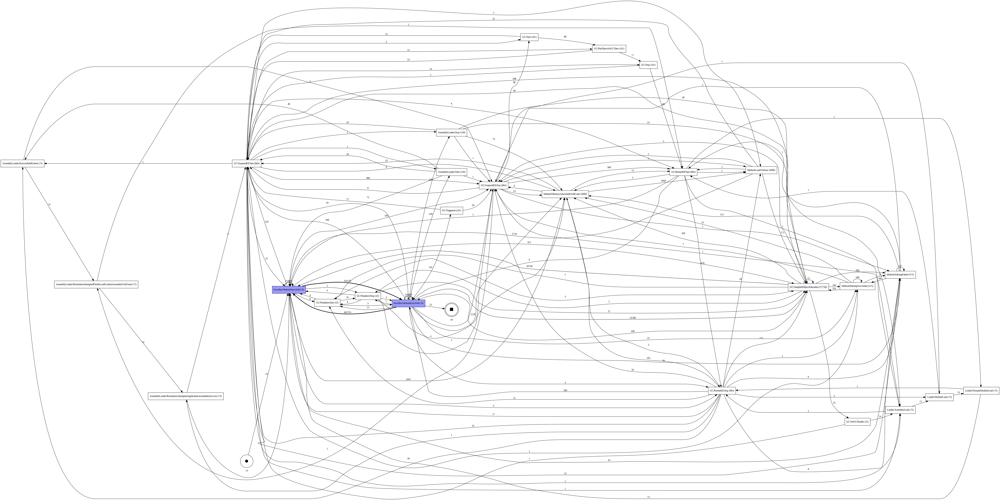

In [ ]:
pm4py.view_dfg(*pm4py.discover_directly_follows_graph(shrinked_log))

In [ ]:
del shrinked_log

### DFG for Methods (first launch)

In [ ]:
first_launch = launches[0]
shorten_copy = first_launch[first_launch['concept:name'].str.startswith(method_start_prefix) | first_launch['concept:name'].str.startswith(method_end_prefix)]

def shorten_name(name):
  method_start = 'Procfiler/MethodStart' in name
  method_name = name.split('_', maxsplit=1)[1][1:-1]
  result = ''
  for part in method_name.split('.'):
    if part == 'SYSTEM':
      result += 'S.'
    else:
      result += part + '.'
  if method_start:
    return result
  else:
    return '*' + result

shorten_copy['concept:name'] = shorten_copy['concept:name'].apply(shorten_name)
shorten_copy

<ipython-input-18-86bdfd3891c7>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shorten_copy['concept:name'] = shorten_copy['concept:name'].apply(shorten_name)


,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.S.STR...,8,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,S.COLLECTIONS.GENERIC.LIST`1[SYSTEM.__CANON].....,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,S.OBJECT..CTOR[INSTANCE.VOID..()].,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,*S.OBJECT..CTOR[INSTANCE.VOID..()].,12,16228,0,NaN,NaN
5,1971-01-06 17:54:15.412591+00:00,S.COLLECTIONS.GENERIC.LIST`1[SYSTEM.__CANON].....,13,16228,0,NaN,NaN
...,...,...,...,...,...,...,...
53506,1971-01-06 17:54:15.484657+00:00,*S.IO.TEXTWRITER.WRITELINE[INSTANCE.VOID..()].,53514,16228,0,NaN,NaN
53507,1971-01-06 17:54:15.484657+00:00,*S.IO.TEXTWRITER.WRITELINE[INSTANCE.VOID..(INT...,53515,16228,0,NaN,NaN
53508,1971-01-06 17:54:15.484658+00:00,*S.IO.TEXTWRITER+SYNCTEXTWRITER.WRITELINE[INST...,53516,16228,0,NaN,NaN
53509,1971-01-06 17:54:15.484658+00:00,*S.CONSOLE.WRITELINE[VOID..(INT32)].,53517,16228,0,NaN,NaN


In [ ]:
from pm4py.visualization.dfg import visualizer as dfg_visualization
dfg = pm4py.discover_directly_follows_graph(shorten_copy)[0]
gviz = dfg_visualization.apply(dfg, log=shorten_copy, parameters={'format': 'svg'})
dfg_visualization.save(gviz, 'methods_per_launch.svg')
None

/usr/local/lib/python3.10/dist-packages/pm4py/algo/discovery/dfg/adapters/pandas/df_statistics.py:73: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[start_timestamp_key] = df[timestamp_key]


Notice, that after `Console.WriteLine(...)` invocation our program stops.  
This is concluded from the method DFG. Same conclusions can be made from DFG containing flow after `Console.WriteLine(...)`

In [ ]:
console_write_name = "Procfiler/MethodStart_{SYSTEM.CONSOLE.WRITELINE[VOID..(INT32)]}"

In [ ]:
from pm4py.visualization.dfg import visualizer as dfg_visualization

raw_methods_log = first_launch[first_launch['concept:name'].str.startswith(method_start_prefix) | first_launch['concept:name'].str.startswith(method_end_prefix)]
methods_per_launch_after = pm4py.filter_between(raw_methods_log, console_write_name, main_end_name)

dfg = pm4py.discover_directly_follows_graph(methods_per_launch_after)[0]
gviz = dfg_visualization.apply(dfg, log=methods_per_launch_after, parameters={'format': 'svg'})
dfg_visualization.save(gviz, 'after_console_writeline.svg')
None

# SANDBOX

In [ ]:
pm4py.discovery.discover_log_skeleton(log)

KeyboardInterrupt: ignored

In [ ]:
log['lifecycle:transition'].unique()

In [ ]:
log[~log['lifecycle:transition'].isna()]["concept:name"].unique()

In [ ]:
for event in log['concept:instance'].unique():
  print(event)

In [ ]:
log[log['concept:name'].str.contains("GC/Start_")]

In [ ]:
launches[0][launches[0]["concept:name"].str.contains("\.ADD")]

In [ ]:
def extract_subcategory(name):
  data = name.split('/', maxsplit=1)
  return data[0] + "/" + data[1].split('_')[0]

shorten_copy_cp = log.copy(deep=True)
shorten_copy_cp["concept:name"] = shorten_copy_cp["concept:name"].apply(extract_subcategory)
shorten_copy_cp.head()

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,Procfiler/MethodStart,8,16228,0,NaN,NaN
1,1971-01-06 17:54:15.412579+00:00,GC/SampledObjectAllocation,9,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,Procfiler/MethodStart,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,Procfiler/MethodStart,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,Procfiler/MethodEnd,12,16228,0,NaN,NaN


In [ ]:
shorten_copy_cp["case:concept:name"].value_counts()

In [ ]:
shorten_copy_cp["case:concept:name"].value_counts()

In [ ]:
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.visualization.petri_net import visualizer as pn_visualizer

net, initial_marking, final_marking = alpha_miner.apply(shorten_copy_cp)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
cases = shorten_copy_cp["case:concept:name"].unique()
concept_names = shorten_copy_cp["concept:name"].unique()

In [ ]:
# concept_names = ["GC/Stop", "GC/PinObjectAtGCTime", "GC/Triggered", "GC/Start"]
for concept in concept_names:
  for cs in cases:
    ct = len(shorten_copy_cp[(shorten_copy_cp["case:concept:name"] == cs) & (shorten_copy_cp["concept:name"] == concept)])
    if ct != 4:
      print(cs, concept, ct)

In [ ]:
shorten_copy_cp["concept:name"].value_counts()

In [ ]:
log[log["case:concept:name"] == "9"]

In [ ]:
check = log[log["case:concept:name"] == "9"].copy(deep=True)
check["concept:name"] = check["concept:name"].apply(lambda x: "GC/Start" if x.startswith("GC/Start") else ( "GC/Stop" if x.startswith("GC/Stop") else x))
filtered_log = pm4py.filter_between(check, "GC/Start", "GC/Stop")

#check = check[check["concept:name"].str.startswith("GC/PinObjectAtGCTime")]
filtered_log

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)
launch_0.head()

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,MethodStart,8,16228,0,NaN,NaN
1,1971-01-06 17:54:15.412579+00:00,SampledObjectAllocation,9,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,MethodStart,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,MethodStart,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,MethodEnd,12,16228,0,NaN,NaN


In [ ]:
shorten_copy_cp["concept:name"].value_counts()

NameError: ignored

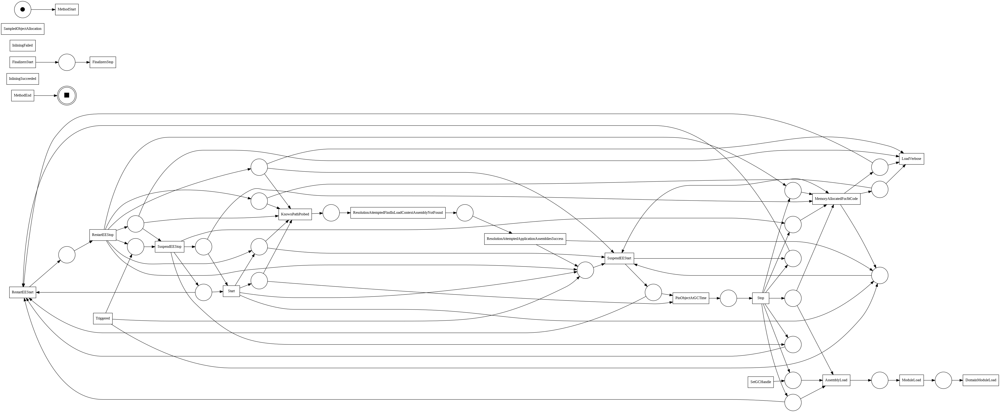

In [ ]:
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.visualization.petri_net import visualizer as pn_visualizer

net, initial_marking, final_marking = alpha_miner.apply(launch_0)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.algo.discovery.heuristics import algorithm as heuristics_miner
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

tree = inductive_miner.apply(launch_0)

gviz = pt_visualizer.apply(tree)
pt_visualizer.view(gviz)

In [ ]:
gviz = pt_visualizer.apply(tree, parameters={"format": "png"})
pt_visualizer.save(gviz, 'inductive_1.svg')
None

In [ ]:
from pm4py.objects.conversion.process_tree import converter as pt_converter
net, initial_marking, final_marking = pt_converter.apply(tree, variant=pt_converter.Variants.TO_PETRI_NET)

gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
net, im, fm = pm4py.discover_petri_net_heuristics(launch_0)

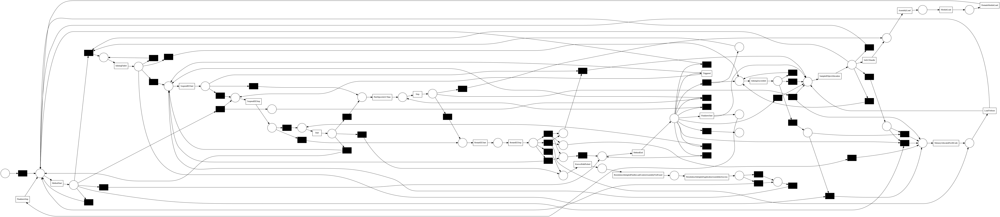

In [ ]:
gviz = pn_visualizer.apply(net, initial_marking)
pn_visualizer.view(gviz)

In [ ]:
net, im, fm = pm4py.discover_petri_net_heuristics(launch_0, dependency_threshold=0.7)

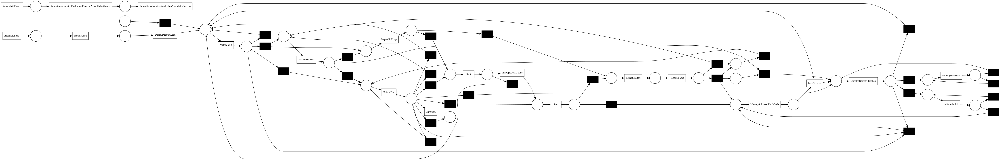

In [ ]:
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
net, im, fm = pm4py.discover_petri_net_heuristics(launch_0, dependency_threshold=0.7, and_threshold=0.5)

In [ ]:
gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters={"format": "svg"})
pn_visualizer.save(gviz, "heurisitc_2.svg")

/usr/local/lib/python3.10/dist-packages/pm4py/utils.py:508: UserWarning: the EventLog class has been deprecated and will be removed in a future release.
  warnings.warn("the EventLog class has been deprecated and will be removed in a future release.")


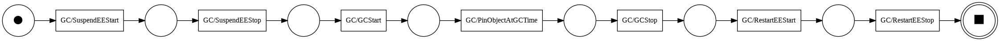

In [ ]:
import pm4py
from pm4py.objects.log.obj import EventLog, Trace, Event
from pm4py.util import xes_constants

log1 = EventLog()

def add_trace(events):
  trace_1 = Trace()
  for event in events:
    trace_1.append(Event({xes_constants.DEFAULT_NAME_KEY: event}))
  log1.append(trace_1)

add_trace(["GC/SuspendEEStart", "GC/SuspendEEStop", "GC/GCStart", "GC/PinObjectAtGCTime", "GC/GCStop", "GC/RestartEEStart", "GC/RestartEEStop"])

net, initial_marking, final_marking = pm4py.discover_petri_net_alpha(log1)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
heu_net = heuristics_miner.apply_heu(launch_0, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})
gviz = hn_visualizer.apply(heu_net)
hn_visualizer.view(gviz)

In [ ]:
heu_net = heuristics_miner.apply_heu(launches[0], parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.529662 to fit



In [ ]:
gviz = hn_visualizer.apply(heu_net, parameters={"format": "svg"})
hn_visualizer.save(gviz, "tmp_1.svg")

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)

In [ ]:
heu_net = heuristics_miner.apply_heu(launch_0, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})

In [ ]:
gviz = hn_visualizer.apply(heu_net, parameters={"format": "svg"})
hn_visualizer.save(gviz, "heu_0.svg")

In [ ]:
for i in range(25):
  launch_i = launches[i].copy(deep=True)
  launch_i["concept:name"] = launch_i["concept:name"].apply(extract_subcategory)
  heu_net = heuristics_miner.apply_heu(launch_i, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})
  gviz = hn_visualizer.apply(heu_net, parameters={"format": "svg"})
  hn_visualizer.save(gviz, "heu_" + str(i) + ".svg")

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)
launch_0["concept:name"].value_counts()

Procfiler/MethodStart                                                  25970
Procfiler/MethodEnd                                                    25970
GC/SampledObjectAllocation                                              1110
Method/LoadVerbose                                                       120
Method/MemoryAllocatedForJitCode                                         120
GC/SuspendEEStop                                                          34
GC/RestartEEStart                                                         34
GC/SuspendEEStart                                                         34
GC/RestartEEStop                                                          34
Method/InliningSucceeded                                                  19
Method/InliningFailed                                                     15
AssemblyLoader/Start                                                       6
AssemblyLoader/Stop                                                        6

In [ ]:
launch_2 = launches[2].copy(deep=True)
launch_2["concept:name"] = launch_2["concept:name"].apply(extract_subcategory)
launch_2["concept:name"].value_counts()

Procfiler/MethodStart                                                  25910
Procfiler/MethodEnd                                                    25910
GC/SampledObjectAllocation                                              1110
Method/LoadVerbose                                                       120
Method/MemoryAllocatedForJitCode                                         120
GC/RestartEEStart                                                         27
GC/SuspendEEStop                                                          27
GC/RestartEEStop                                                          27
GC/SuspendEEStart                                                         27
Method/InliningSucceeded                                                  19
Method/InliningFailed                                                     15
AssemblyLoader/Start                                                       6
AssemblyLoader/Stop                                                        6

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)

In [ ]:
info = []
start = False
for row in launch_0.values:
  if row[1] == 'Procfiler/MethodEnd' or row[1] == 'Procfiler/MethodStart':
    continue
  if row[1].startswith("GC/"):
    info.append(row[1])

info

['GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/Sam

In [ ]:
info[:500]

['GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/Sam

In [ ]:
info[500:]

['GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/SampledObjectAllocation',
 'GC/Sam

In [ ]:
launch_2 = launches[2].copy(deep=True)
launch_2["concept:name"] = launch_2["concept:name"].apply(extract_subcategory)
# log_tmp = pm4py.filter_between(launch_0, "GC/SuspendEEStart", "GC/RestartEEStop")
# log_tmp["concept:name"].value_counts()

In [ ]:
info = []
start = False
for row in launch_2.values:
  if row[1] == "GC/SuspendEEStart":
    start = True
    info.append([row[1]])
  elif row[1] == "GC/RestartEEStop":
    start = False
    info[-1].append(row[1])
  elif start:
    info[-1].append(row[1])

l2_map = dict()
for l in info:
  cor = tuple(i for i in l)
  if cor not in l2_map.keys():
    l2_map[cor] = 1
  else:
    l2_map[cor] += 1
l2_map

In [ ]:
for key, value in l0_map.items():
  print(value, l2_map[key])

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)
launch_0

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
0,1971-01-06 17:54:15.412502+00:00,Procfiler/MethodStart,8,16228,0,NaN,NaN
1,1971-01-06 17:54:15.412579+00:00,GC/SampledObjectAllocation,9,16228,0,NaN,NaN
2,1971-01-06 17:54:15.412580+00:00,Procfiler/MethodStart,10,16228,0,NaN,NaN
3,1971-01-06 17:54:15.412581+00:00,Procfiler/MethodStart,11,16228,0,NaN,NaN
4,1971-01-06 17:54:15.412582+00:00,Procfiler/MethodEnd,12,16228,0,NaN,NaN
...,...,...,...,...,...,...,...
53506,1971-01-06 17:54:15.484657+00:00,Procfiler/MethodEnd,53514,16228,0,NaN,NaN
53507,1971-01-06 17:54:15.484657+00:00,Procfiler/MethodEnd,53515,16228,0,NaN,NaN
53508,1971-01-06 17:54:15.484658+00:00,Procfiler/MethodEnd,53516,16228,0,NaN,NaN
53509,1971-01-06 17:54:15.484658+00:00,Procfiler/MethodEnd,53517,16228,0,NaN,NaN


In [ ]:
launch_0["concept:name"].value_counts()

Procfiler/MethodStart                                                  25970
Procfiler/MethodEnd                                                    25970
GC/SampledObjectAllocation                                              1110
Method/LoadVerbose                                                       120
Method/MemoryAllocatedForJitCode                                         120
GC/SuspendEEStop                                                          34
GC/RestartEEStart                                                         34
GC/SuspendEEStart                                                         34
GC/RestartEEStop                                                          34
Method/InliningSucceeded                                                  19
Method/InliningFailed                                                     15
AssemblyLoader/Start                                                       6
AssemblyLoader/Stop                                                        6

In [ ]:
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.algo.discovery.heuristics import algorithm as heuristics_miner
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer

heu_net = heuristics_miner.apply_heu(launch_0, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})

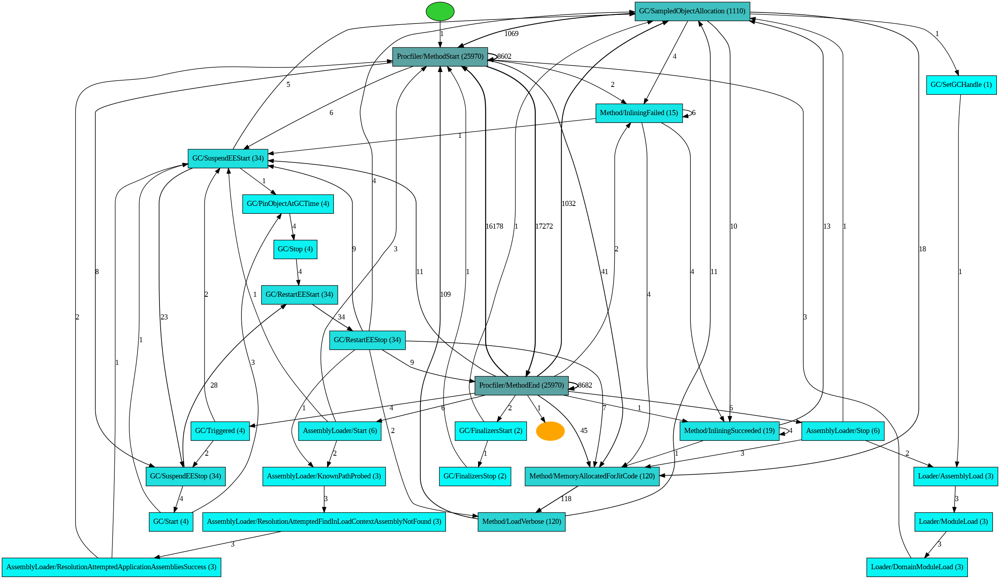

In [ ]:
gviz = hn_visualizer.apply(heu_net)
hn_visualizer.view(gviz)

In [ ]:
gc_delete = ["GC/SampledObjectAllocation", "GC/FinalizersStop", "GC/FinalizersStart", "GC/SetGCHandle"]

In [ ]:
launch_0_gc = launch_0[launch_0["concept:name"].str.startswith("GC/") & (~launch_0["concept:name"].isin(gc_delete))]
launch_0_gc

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
768,1971-01-06 17:54:15.413336+00:00,GC/Triggered,776,16228,0,NaN,NaN
769,1971-01-06 17:54:15.413654+00:00,GC/SuspendEEStart,777,-1,0,start,SuspendEE_350
770,1971-01-06 17:54:15.413664+00:00,GC/SuspendEEStop,778,-1,0,complete,SuspendEE_350
771,1971-01-06 17:54:15.413715+00:00,GC/Start,779,-1,0,start,GC_1
772,1971-01-06 17:54:15.414376+00:00,GC/SuspendEEStart,780,-1,0,start,SuspendEE_351
...,...,...,...,...,...,...,...
52733,1971-01-06 17:54:15.482384+00:00,GC/RestartEEStop,52741,-1,0,complete,RestartEE_382
53414,1971-01-06 17:54:15.484367+00:00,GC/SuspendEEStart,53422,-1,0,start,SuspendEE_383
53415,1971-01-06 17:54:15.484377+00:00,GC/SuspendEEStop,53423,-1,0,complete,SuspendEE_383
53417,1971-01-06 17:54:15.484403+00:00,GC/RestartEEStart,53425,-1,0,start,RestartEE_383


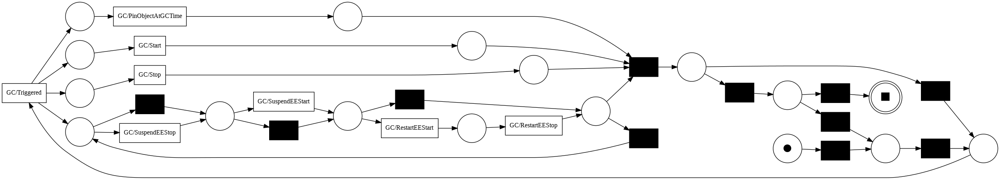

In [ ]:
from pm4py.objects.conversion.process_tree import converter as pt_converter

tree = inductive_miner.apply(launch_0_gc)

net, initial_marking, final_marking = pt_converter.apply(tree, variant=pt_converter.Variants.TO_PETRI_NET)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

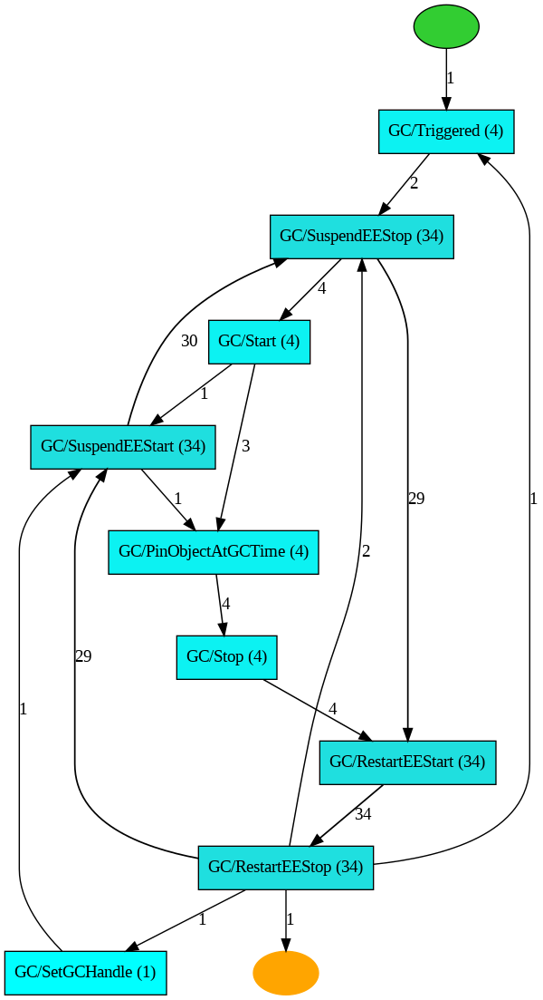

In [ ]:
heu_net = heuristics_miner.apply_heu(launch_0_gc, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})
gviz = hn_visualizer.apply(heu_net)
hn_visualizer.view(gviz)

/usr/local/lib/python3.10/dist-packages/pm4py/algo/discovery/dfg/adapters/pandas/df_statistics.py:73: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[start_timestamp_key] = df[timestamp_key]


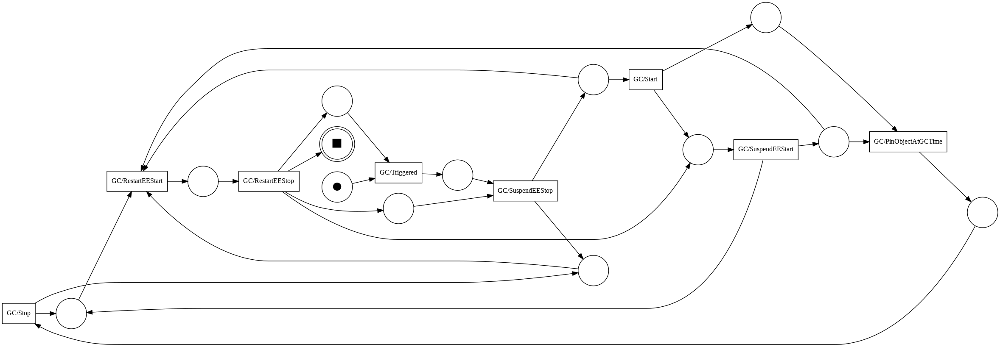

In [ ]:
net, initial_marking, final_marking = alpha_miner.apply(launch_0_gc)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

In [ ]:
check = [row[1] for row in launch_0_gc.values]
check

['GC/Triggered',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/Start',
 'GC/SuspendEEStart',
 'GC/PinObjectAtGCTime',
 'GC/Stop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/Triggered',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/Start',
 'GC/PinObjectAtGCTime',
 'GC/Stop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/Triggered',
 'GC/SuspendEEStop',
 'GC/RestartEEStart',
 'GC/RestartEEStop',
 'GC/SuspendEEStart',
 'GC/SuspendEEStop',
 'GC/Start',
 'GC/PinObjectAtGCT

In [ ]:
launch_0_gc.index

Int64Index([  768,   769,   770,   771,   772,   773,   774,   775,   776,
              862,
            ...
            52437, 52438, 52730, 52731, 52732, 52733, 53414, 53415, 53417,
            53418],
           dtype='int64', length=152)

In [ ]:
log.iloc[772, :]

time:timestamp          1971-01-06 17:54:15.414376+00:00
concept:name                   GC/SuspendEEStart_{OTHER}
Event_ID                                             780
ManagedThreadId                                       -1
case:concept:name                                      0
lifecycle:transition                               start
concept:instance                           SuspendEE_351
Name: 772, dtype: object

In [ ]:
log[log["concept:name"].str.startswith("GC/SuspendEEStart")]["concept:name"].value_counts()

GC/SuspendEEStart_{OTHER}    583
GC/SuspendEEStart_{GC}       101
Name: concept:name, dtype: int64

In [ ]:
launch_0 = launches[0][launches[0]["concept:name"].str.startswith("GC/")].copy(deep=True)
# launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)
launch_0["concept:name"].value_counts()

GC/SampledObjectAllocation_{System.Byte[]}                                                           1001
GC/RestartEEStart                                                                                      34
GC/SuspendEEStop                                                                                       34
GC/RestartEEStop                                                                                       34
GC/SuspendEEStart_{OTHER}                                                                              30
GC/SampledObjectAllocation_{System.String}                                                             23
GC/SampledObjectAllocation_{System.SByte[]}                                                            23
GC/SampledObjectAllocation_{System.Threading.ExecutionContext}                                         12
GC/SampledObjectAllocation_{OneElementAsyncLocalValueMap}                                              12
GC/SampledObjectAllocation_{System.Byte[][]}  

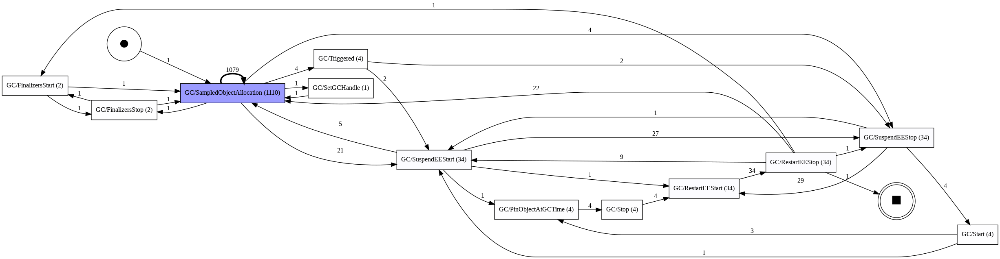

In [ ]:
pm4py.view_dfg(*pm4py.discover_directly_follows_graph(launch_0))

In [ ]:
launches[0][launches[0]["concept:name"].str.startswith("GC/")]["concept:name"].value_counts()

GC/SampledObjectAllocation_{System.Byte[]}                                                           1001
GC/RestartEEStart                                                                                      34
GC/SuspendEEStop                                                                                       34
GC/RestartEEStop                                                                                       34
GC/SuspendEEStart_{OTHER}                                                                              30
GC/SampledObjectAllocation_{System.String}                                                             23
GC/SampledObjectAllocation_{System.SByte[]}                                                            23
GC/SampledObjectAllocation_{System.Threading.ExecutionContext}                                         12
GC/SampledObjectAllocation_{OneElementAsyncLocalValueMap}                                              12
GC/SampledObjectAllocation_{System.Byte[][]}  

In [ ]:
del_from_gc = ["GC/SampledObjectAllocation", "GC/SetGCHandle"]
launch_0 = launches[0][launches[0]["concept:name"].str.startswith("GC/") & (~launches[0]["concept:name"].apply(extract_subcategory).isin(del_from_gc))]

In [ ]:
def rewrite_suspend_stop(x):
  name = x["concept:name"]
  instance = x["concept:instance"]
  if name.startswith("GC/SuspendEEStop"):
    arr = launch_0.dropna()
    start = arr[(arr["concept:instance"] == instance) & arr["concept:name"].str.startswith("GC/SuspendEEStart")]["concept:name"].iloc[0]
    # print(x, start)
    if start == "GC/SuspendEEStart_{GC}":
      ans = {"concept:name": "GC/SuspendEEStop_{GC}", "concept:instance": instance}
    elif start == "GC/SuspendEEStart_{OTHER}":
      ans = {"concept:name": "GC/SuspendEEStop_{OTHER}", "concept:instance": instance}
    else:
      ans = x
    return ans
  return x
launch_0_check = launch_0.copy(deep=True)
launch_0_check["concept:name"] = launch_0_check[["concept:name", "concept:instance"]].apply(rewrite_suspend_stop, axis=1)["concept:name"]

In [ ]:
launch_0_check

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
768,1971-01-06 17:54:15.413336+00:00,GC/Triggered_{ALLOC_LARGE},776,16228,0,NaN,NaN
769,1971-01-06 17:54:15.413654+00:00,GC/SuspendEEStart_{GC},777,-1,0,start,SuspendEE_350
770,1971-01-06 17:54:15.413664+00:00,GC/SuspendEEStop_{GC},778,-1,0,complete,SuspendEE_350
771,1971-01-06 17:54:15.413715+00:00,GC/Start_{ALLOC_LARGENC_GC},779,-1,0,start,GC_1
772,1971-01-06 17:54:15.414376+00:00,GC/SuspendEEStart_{OTHER},780,-1,0,start,SuspendEE_351
...,...,...,...,...,...,...,...
52733,1971-01-06 17:54:15.482384+00:00,GC/RestartEEStop,52741,-1,0,complete,RestartEE_382
53414,1971-01-06 17:54:15.484367+00:00,GC/SuspendEEStart_{OTHER},53422,-1,0,start,SuspendEE_383
53415,1971-01-06 17:54:15.484377+00:00,GC/SuspendEEStop_{OTHER},53423,-1,0,complete,SuspendEE_383
53417,1971-01-06 17:54:15.484403+00:00,GC/RestartEEStart,53425,-1,0,start,RestartEE_383


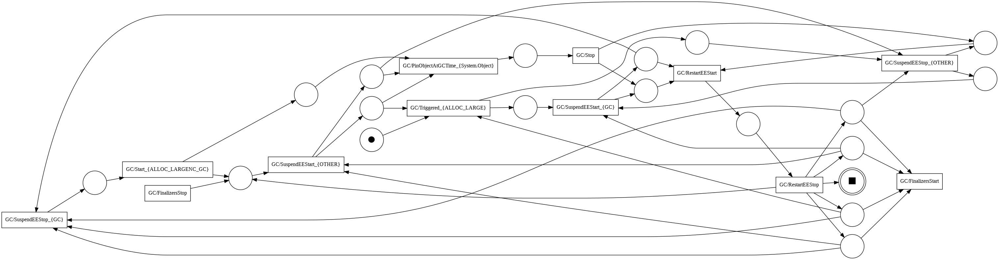

In [ ]:
net, initial_marking, final_marking = alpha_miner.apply(launch_0_check)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

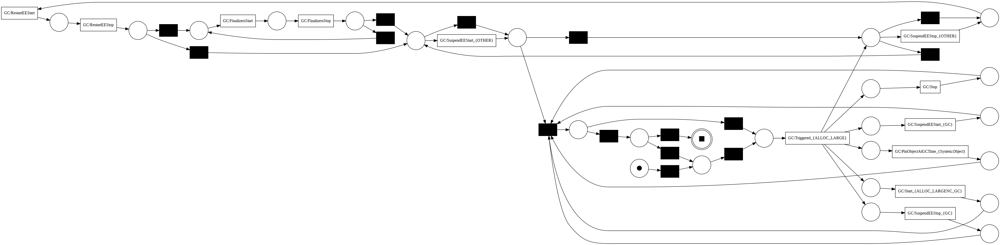

In [ ]:
tree = inductive_miner.apply(launch_0_check)

net, initial_marking, final_marking = pt_converter.apply(tree, variant=pt_converter.Variants.TO_PETRI_NET)
gviz = pn_visualizer.apply(net, initial_marking, final_marking)
pn_visualizer.view(gviz)

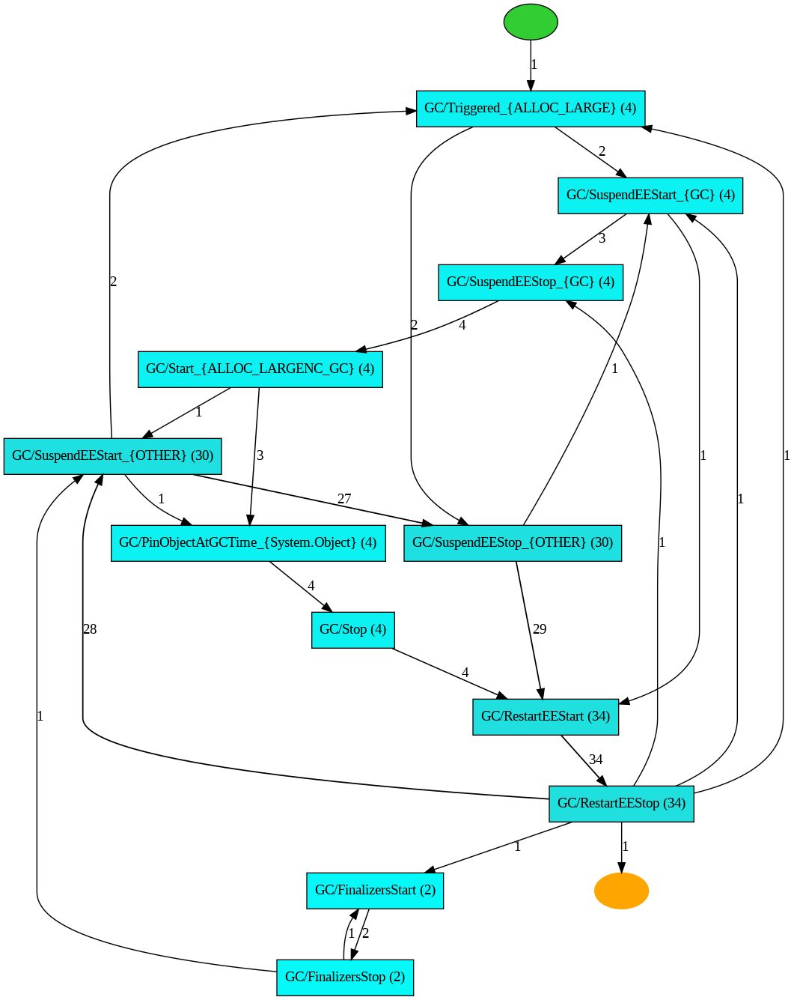

In [ ]:
heu_net = heuristics_miner.apply_heu(launch_0_check, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.3})
gviz = hn_visualizer.apply(heu_net)
hn_visualizer.view(gviz)

In [ ]:
launches[0][50471 - 5]

In [ ]:
launches[0][launches[0]["concept:name"] == "GC/SetGCHandle_{STRONG}"]

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
50471,1971-01-06 17:54:15.465780+00:00,GC/SetGCHandle_{STRONG},50479,16228,0,NaN,NaN


In [ ]:
launch_0_tmp = launch_0.copy(deep=True)

In [ ]:
loader_launch_0 = launches[0].copy(deep=True)
loader_launch_0["concept:name"] = loader_launch_0["concept:name"].apply(extract_subcategory)
indexes = loader_launch_0[(loader_launch_0["concept:name"] == "AssemblyLoader/Start") | (loader_launch_0["concept:name"] == "AssemblyLoader/Stop")].index

In [ ]:
for ind in indexes:
  print(launches[0].iloc[ind - 10: ind + 10, :]["concept:name"])

50246    Procfiler/MethodEnd_{SYSTEM.RUNTIME.COMPILERSE...
50247    Procfiler/MethodEnd_{SYSTEM.RUNTIME.COMPILERSE...
50248    Procfiler/MethodStart_{SYSTEM.THREADING.ASYNCL...
50249    Procfiler/MethodEnd_{SYSTEM.THREADING.ASYNCLOC...
50250    Procfiler/MethodStart_{SYSTEM.THREADING.TASKS....
50251    Procfiler/MethodEnd_{SYSTEM.THREADING.TASKS.TP...
50252    Procfiler/MethodEnd_{SYSTEM.THREADING.ASYNCLOC...
50253    Procfiler/MethodEnd_{SYSTEM.THREADING.EXECUTIO...
50254    Procfiler/MethodEnd_{SYSTEM.THREADING.ASYNCLOC...
50255    Procfiler/MethodEnd_{SYSTEM.RUNTIME.LOADER.ASS...
50256              AssemblyLoader/Start_{System.Threading}
50257    AssemblyLoader/KnownPathProbed_{C:\Program Fil...
50258    AssemblyLoader/ResolutionAttemptedFindInLoadCo...
50259    AssemblyLoader/ResolutionAttemptedApplicationA...
50260    Procfiler/MethodStart_{SYSTEM.RUNTIME.LOADER.A...
50261    Procfiler/MethodStart_{SYSTEM.STRING.ENDSWITH[...
50262    Procfiler/MethodStart_{SYSTEM.STRING.GET_LENGT.

time:timestamp          1971-01-06 17:54:15.481790+00:00
concept:name                                        None
Event_ID                                           52737
ManagedThreadId                                    16228
case:concept:name                                      0
lifecycle:transition                               start
concept:instance                       AssemblyLoader_11
Name: 52729, dtype: object

In [ ]:
def extract_subcategory_loader(name):
  data = name.split('/', maxsplit=1)
  category = data[0]
  subcategory = data[1].split('_')[0]
  if category == "AssemblyLoader" and (name != "AssemblyLoader/Start_{System.Private.CoreLib}" and name != "AssemblyLoader/Stop_{System.Private.CoreLib}"):
    return category + "/" + subcategory
  else:
    return name

loader_launch_0_tmp = launches[0][~launches[0]["concept:name"].str.startswith("GC/")].copy(deep=True)
loader_launch_0_tmp["concept:name"] = loader_launch_0_tmp["concept:name"].apply(extract_subcategory_loader)


loader_launch_0_tmp
filtered_log = pm4py.filter_between(loader_launch_0_tmp, "AssemblyLoader/Start", "AssemblyLoader/Stop")

vals = filtered_log["concept:name"].value_counts()
#vals[vals < 10]

In [ ]:
loader_launch_0_tmp.values

array([[Timestamp('1971-01-06 17:54:15.412502+0000', tz='UTC'),
        'Procfiler/MethodStart_{LOHALLOCATIONS.PROGRAM.MAIN[VOID..(CLASS.SYSTEM.STRING[])]}',
        '8', ..., '0', nan, nan],
       [Timestamp('1971-01-06 17:54:15.412580+0000', tz='UTC'),
        'Procfiler/MethodStart_{SYSTEM.COLLECTIONS.GENERIC.LIST`1[SYSTEM.__CANON]..CTOR[INSTANCE.VOID..()]}',
        '10', ..., '0', nan, nan],
       [Timestamp('1971-01-06 17:54:15.412581+0000', tz='UTC'),
        'Procfiler/MethodStart_{SYSTEM.OBJECT..CTOR[INSTANCE.VOID..()]}',
        '11', ..., '0', nan, nan],
       ...,
       [Timestamp('1971-01-06 17:54:15.484658+0000', tz='UTC'),
        'Procfiler/MethodEnd_{SYSTEM.IO.TEXTWRITER+SYNCTEXTWRITER.WRITELINE[INSTANCE.VOID..(INT32)]}',
        '53516', ..., '0', nan, nan],
       [Timestamp('1971-01-06 17:54:15.484658+0000', tz='UTC'),
        'Procfiler/MethodEnd_{SYSTEM.CONSOLE.WRITELINE[VOID..(INT32)]}',
        '53517', ..., '0', nan, nan],
       [Timestamp('1971-01-06 17:5

In [ ]:
vals.iloc[:40]

Procfiler/MethodStart_{SYSTEM.STRING.GET_LENGTH[INSTANCE.INT32..()]}                                                                                                              144
Procfiler/MethodEnd_{SYSTEM.STRING.GET_LENGTH[INSTANCE.INT32..()]}                                                                                                                144
Procfiler/MethodEnd_{INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS[GENERIC.!!1&..(!!0&)]}                                                                                            48
Procfiler/MethodStart_{INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS[GENERIC.!!1&..(!!0&)]}                                                                                          48
Procfiler/MethodEnd_{INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.SIZEOF[GENERIC.INT32..()]}                                                                                           24
Procfiler/MethodStart_{SYSTEM.RUNTIME.INTEROPSERVICES.MEMORYMARSHAL.GETREFERENCE[GENERIC.!

In [ ]:
vals.iloc[40:]

In [ ]:
net, initial_marking, final_marking = alpha_miner.apply(filtered_log)
gviz = pn_visualizer.apply(net, initial_marking, final_marking, parameters={"format": "svg"})
pn_visualizer.save(gviz, "loader_0.svg")

In [ ]:
heu_net = heuristics_miner.apply_heu(filtered_log, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.5})
gviz = hn_visualizer.apply(heu_net, parameters={"format": "svg"})
hn_visualizer.save(gviz, "loader_2.svg")

In [ ]:
indexes = loader_launch_0_tmp[(loader_launch_0_tmp["concept:name"] == "AssemblyLoader/Start")].index

In [ ]:
len(indexes)

3

In [ ]:
for ind in indexes[1:2]:
  print(launches[0].iloc[ind - 10: ind + 800, :]["concept:name"].values)

['Procfiler/MethodEnd_{SYSTEM.RUNTIME.COMPILERSERVICES.RUNTIMEHELPERS.GETMETHODTABLE[VALUE.CLASS.SYSTEM.RUNTIME.COMPILERSERVICES.METHODTABLE*..(CLASS.SYSTEM.OBJECT)]}'
 'Procfiler/MethodEnd_{SYSTEM.RUNTIME.COMPILERSERVICES.CASTHELPERS.CHKCASTANY[CLASS.SYSTEM.OBJECT..(VOID*,CLASS.SYSTEM.OBJECT)]}'
 'Procfiler/MethodStart_{SYSTEM.THREADING.ASYNCLOCALVALUECHANGEDARGS`1[SYSTEM.__CANON]..CTOR[INSTANCE.VOID..(!0,!0,BOOL)]}'
 'Procfiler/MethodEnd_{SYSTEM.THREADING.ASYNCLOCALVALUECHANGEDARGS`1[SYSTEM.__CANON]..CTOR[INSTANCE.VOID..(!0,!0,BOOL)]}'
 'Procfiler/MethodStart_{SYSTEM.THREADING.TASKS.TPLEVENTSOURCE.SETACTIVITYID[INSTANCE.VOID..(VALUE.CLASS.SYSTEM.GUID)]}'
 'Procfiler/MethodEnd_{SYSTEM.THREADING.TASKS.TPLEVENTSOURCE.SETACTIVITYID[INSTANCE.VOID..(VALUE.CLASS.SYSTEM.GUID)]}'
 'Procfiler/MethodEnd_{SYSTEM.THREADING.ASYNCLOCAL`1[SYSTEM.__CANON].SYSTEM.THREADING.IASYNCLOCAL.ONVALUECHANGED[INSTANCE.VOID..(CLASS.SYSTEM.OBJECT,CLASS.SYSTEM.OBJECT,BOOL)]}'
 'Procfiler/MethodEnd_{SYSTEM.THREADIN

In [ ]:
for i in range(25):
  launch_i = launches[i].copy(deep=True)
  launch_i["concept:name"] = launch_i["concept:name"].apply(extract_subcategory)
  print(i, launch_i["concept:name"].value_counts()["AssemblyLoader/Start"])

0 6
1 6
2 6
3 6
4 6
5 6
6 6
7 6
8 6
9 6
10 6
11 6
12 6
13 6
14 6
15 6
16 6
17 6
18 6
19 6
20 6
21 6
22 6
23 6
24 6


In [ ]:
launch_1["concept:name"].value_counts()

Procfiler/MethodStart                                                  25910
Procfiler/MethodEnd                                                    25910
GC/SampledObjectAllocation                                              1110
Method/LoadVerbose                                                       120
Method/MemoryAllocatedForJitCode                                         120
GC/RestartEEStart                                                         27
GC/SuspendEEStop                                                          27
GC/RestartEEStop                                                          27
GC/SuspendEEStart                                                         27
Method/InliningSucceeded                                                  19
Method/InliningFailed                                                     15
AssemblyLoader/Start                                                       6
AssemblyLoader/Stop                                                        6

In [ ]:
launch_0 = launches[0].copy(deep=True)
launch_0["concept:name"] = launch_0["concept:name"].apply(extract_subcategory)
fffff = launch_0.dropna()
kek = fffff[fffff["concept:name"].apply(str.lower).str.contains("load")]["concept:instance"].value_counts()

In [ ]:
kek[:60]

AssemblyLoader_8                                                                                                                                                                                                              2
AssemblyLoader_7                                                                                                                                                                                                              2
AssemblyLoader_10                                                                                                                                                                                                             2
AssemblyLoader_12                                                                                                                                                                                                             2
AssemblyLoader_9                                                                                        

In [ ]:
kek[60:120]

MethodLoadUnload_System.IO.TextWriter_WriteLine_instance void  (int32)                                                                                                   1
MethodLoadUnload_System.IO.TextWriter+SyncTextWriter_WriteLine_instance void  (int32)                                                                                    1
MethodLoadUnload_System.IO.TextWriter+SyncTextWriter_.ctor_instance void  (class System.IO.TextWriter)                                                                   1
MethodLoadUnload_System.IO.TextWriter_Synchronized_class System.IO.TextWriter  (class System.IO.TextWriter)                                                              1
MethodLoadUnload_System.ReadOnlySpan`1[System.Byte]_.ctor_instance void  (!0[])                                                                                          1
MethodLoadUnload_System.IO.StreamWriter_.ctor_instance void  (class System.IO.Stream,class System.Text.Encoding,int32,bool)                      

In [ ]:
kek[120:]

MethodLoadUnload_System.Text.EncoderFallback_get_ReplacementFallback_class System.Text.EncoderFallback  ()         1
MethodLoadUnload_System.Text.Encoding_SetDefaultFallbacks_instance void  ()                                        1
MethodLoadUnload_System.Text.OSEncoding_.ctor_instance void  (int32)                                               1
MethodLoadUnload_System.Text.Encoding_get_CodePage_instance int32  ()                                              1
MethodLoadUnload_System.Text.Encoding_.cctor_void  ()                                                              1
MethodLoadUnload_System.Text.Encoding_get_Default_class System.Text.Encoding  ()                                   1
MethodLoadUnload_System.LocalAppContextSwitches_GetSwitchDefaultValue_bool  (class System.String)                  1
MethodLoadUnload_System.LocalAppContextSwitches_GetCachedSwitchValueInternal_bool  (class System.String,int32&)    1
MethodLoadUnload_System.ReadOnlySpan`1[System.Char]_.ctor_instan

In [ ]:
info = []
for row in loader_launch_0_tmp.values:
  cat_info = extract_subcategory(row[1])
  if (cat_info == "Procfiler/MethodStart" or cat_info == "Procfiler/MethodEnd"):
    continue
  if (cat_info == "AssemblyLoader/Start" and row[1] != "AssemblyLoader/Start_{System.Private.CoreLib}"):
    info.append([row[1]])
  else:
    if len(info) == 0:
      info.append([])
    info[-1].append(row[1])

In [ ]:
print(info[1], sep="\n")

['AssemblyLoader/Start', 'AssemblyLoader/KnownPathProbed', 'AssemblyLoader/ResolutionAttemptedFindInLoadContextAssemblyNotFound', 'AssemblyLoader/ResolutionAttemptedApplicationAssembliesSuccess', 'AssemblyLoader/Stop', 'Loader/AssemblyLoad_{System.Threading}', 'Loader/ModuleLoad_{System.Threading}', 'Loader/DomainModuleLoad_{C:\\Program Files\\dotnet\\shared\\Microsoft.NETCore.App\\6.0.15\\System.Threading.dll}', 'AssemblyLoader/Start_{System.Private.CoreLib}', 'AssemblyLoader/Stop_{System.Private.CoreLib}', 'Method/MemoryAllocatedForJitCode', 'Method/LoadVerbose_{System.Consoleget_Out}', 'Method/MemoryAllocatedForJitCode', 'Method/LoadVerbose_{System.Console.cctor}', 'Method/MemoryAllocatedForJitCode', 'Method/LoadVerbose_{System.Threading.VolatileRead}', 'Method/MemoryAllocatedForJitCode', 'Method/LoadVerbose_{System.Console<get_Out>g__EnsureInitialized|26_0}', 'Method/MemoryAllocatedForJitCode', 'Method/LoadVerbose_{System.ConsolePalOpenStandardOutput}', 'Method/MemoryAllocatedForJi

In [ ]:
info[0]

['Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Randomget_Shared}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random.cctor}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random+ThreadSafeRandom.ctor}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random.ctor}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Collections.Generic.List`1[System.__Canon]get_Count}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random+ThreadSafeRandomNext}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random+ThreadSafeRandomget_LocalRandom}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Random+ThreadSafeRandomCreate}',
 'Method/InliningSucceeded_{System.Random+ImplBase.ctor}',
 'Method/InliningSucceeded_{System.Object.ctor}',
 'Method/InliningFailed_{InteropGetRandomBytes}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Ran

In [ ]:
info[1]

['AssemblyLoader/Start',
 'AssemblyLoader/KnownPathProbed',
 'AssemblyLoader/ResolutionAttemptedFindInLoadContextAssemblyNotFound',
 'AssemblyLoader/ResolutionAttemptedApplicationAssembliesSuccess',
 'AssemblyLoader/Stop',
 'Loader/AssemblyLoad_{System.Threading}',
 'Loader/ModuleLoad_{System.Threading}',
 'Loader/DomainModuleLoad_{C:\\Program Files\\dotnet\\shared\\Microsoft.NETCore.App\\6.0.15\\System.Threading.dll}',
 'AssemblyLoader/Start_{System.Private.CoreLib}',
 'AssemblyLoader/Stop_{System.Private.CoreLib}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Consoleget_Out}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Console.cctor}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Threading.VolatileRead}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Console<get_Out>g__EnsureInitialized|26_0}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.ConsolePalOpenStandardOutput}',
 'Method/

In [ ]:
info[2]

['AssemblyLoader/Start',
 'AssemblyLoader/KnownPathProbed',
 'AssemblyLoader/ResolutionAttemptedFindInLoadContextAssemblyNotFound',
 'AssemblyLoader/ResolutionAttemptedApplicationAssembliesSuccess',
 'AssemblyLoader/Stop',
 'Loader/AssemblyLoad_{System.Text.Encoding.Extensions}',
 'Loader/ModuleLoad_{System.Text.Encoding.Extensions}',
 'Loader/DomainModuleLoad_{C:\\Program Files\\dotnet\\shared\\Microsoft.NETCore.App\\6.0.15\\System.Text.Encoding.Extensions.dll}',
 'AssemblyLoader/Start_{System.Private.CoreLib}',
 'AssemblyLoader/Stop_{System.Private.CoreLib}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Text.EncodingHelperGetSupportedConsoleEncoding}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Text.EncodingGetEncoding}',
 'Method/InliningFailed_{System.Text.EncodingProviderGetEncoding}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.Text.EncodingProviderGetEncodingFromProvider}',
 'Method/MemoryAllocatedForJitCode',
 'M

In [ ]:
info[3]

['AssemblyLoader/Start',
 'AssemblyLoader/KnownPathProbed',
 'AssemblyLoader/ResolutionAttemptedFindInLoadContextAssemblyNotFound',
 'AssemblyLoader/ResolutionAttemptedApplicationAssembliesSuccess',
 'AssemblyLoader/Stop',
 'Loader/AssemblyLoad_{System.Runtime.InteropServices}',
 'Loader/ModuleLoad_{System.Runtime.InteropServices}',
 'Loader/DomainModuleLoad_{C:\\Program Files\\dotnet\\shared\\Microsoft.NETCore.App\\6.0.15\\System.Runtime.InteropServices.dll}',
 'AssemblyLoader/Start_{System.Private.CoreLib}',
 'AssemblyLoader/Stop_{System.Private.CoreLib}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.ConsolePal+WindowsConsoleStreamWriteFileNative}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.ReadOnlySpan`1[System.Byte]get_IsEmpty}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{System.ReadOnlySpan`1[System.Byte]GetPinnableReference}',
 'Method/MemoryAllocatedForJitCode',
 'Method/LoadVerbose_{Internal.Runtime.CompilerServices.U

In [ ]:
launches[0][launches[0]["concept:name"].str.contains("Method/MemoryAllocatedForJitCode")]

,time:timestamp,concept:name,Event_ID,ManagedThreadId,case:concept:name,lifecycle:transition,concept:instance
1237,1971-01-06 17:54:15.418083+00:00,Method/MemoryAllocatedForJitCode,1245,16228,0,NaN,NaN
1240,1971-01-06 17:54:15.418256+00:00,Method/MemoryAllocatedForJitCode,1248,16228,0,NaN,NaN
1244,1971-01-06 17:54:15.418324+00:00,Method/MemoryAllocatedForJitCode,1252,16228,0,NaN,NaN
1247,1971-01-06 17:54:15.418420+00:00,Method/MemoryAllocatedForJitCode,1255,16228,0,NaN,NaN
1256,1971-01-06 17:54:15.418496+00:00,Method/MemoryAllocatedForJitCode,1264,16228,0,NaN,NaN
...,...,...,...,...,...,...,...
53389,1971-01-06 17:54:15.484194+00:00,Method/MemoryAllocatedForJitCode,53397,16228,0,NaN,NaN
53410,1971-01-06 17:54:15.484282+00:00,Method/MemoryAllocatedForJitCode,53418,16228,0,NaN,NaN
53416,1971-01-06 17:54:15.484380+00:00,Method/MemoryAllocatedForJitCode,53424,16228,0,NaN,NaN
53421,1971-01-06 17:54:15.484496+00:00,Method/MemoryAllocatedForJitCode,53429,16228,0,NaN,NaN


In [ ]:
from collections import defaultdict
m_map = defaultdict(list)
for i in range(25):
  launch_i = launches[i].copy(deep=True)
  launch_i["concept:name"] = launch_i["concept:name"].apply(extract_subcategory)
  m_map[launch_i["concept:name"].value_counts()["Method/LoadVerbose"]].append(i)
sorted(m_map.items())
#  print(i, launch_i["concept:name"].value_counts())

[(120,
  [0,
   1,
   2,
   3,
   4,
   5,
   6,
   7,
   8,
   9,
   10,
   11,
   12,
   13,
   14,
   15,
   16,
   17,
   18,
   19,
   20,
   21,
   22,
   23,
   24])]

In [ ]:
launch_0 = launches[0][launches[0]["concept:name"].str.contains("Procfiler/MethodStart")].copy(deep=True)

In [ ]:
def extract_library(name):
  data = name.split('/', maxsplit=1)
  category = data[0]
  subcategory = data[1].split('_', maxsplit=1)[0]
  other = data[1].split('_', maxsplit=1)[1]
  path_method = other.split('[', maxsplit=1)[0][1:]
  dt = path_method.split(".")

  method = path_method.replace("..", ".")
  #index = len(dt) - 1
  #if dt[-2] == "":
  #  index -= 1
  #lib = ".".join(dt[:index])
  if "+" in method:
    #print(method)
    dt = method.split("+")
    if "." in dt[1]:
      method = dt[0] + "." + dt[1].split(".")[1]
    else:
      method = dt[0] + "." + dt[1]
    #print(method)
    #lib = lib.split("+")[0]
    # print(path_method, lib)
  return method

launch_0["library"] = launch_0["concept:name"].apply(extract_library)

In [ ]:
launch_0["library"].value_counts(sort=True)

INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS                      3309
INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADDBYTEOFFSET           3184
SYSTEM.COLLECTIONS.GENERIC.LIST`1                                2624
SYSTEM.RUNTIME.COMPILERSERVICES.CASTHELPERS.STELEMREF            1800
SYSTEM.RUNTIME.COMPILERSERVICES.RUNTIMEHELPERS.GETMETHODTABLE    1622
                                                                 ... 
SYSTEM.STRING.TOCHARARRAY                                           1
SYSTEM.TEXT.ENCODING.SETDEFAULTFALLBACKS                            1
SYSTEM.TEXT.OSENCODER.CTOR                                          1
SYSTEM.TEXT.ENCODER.CTOR                                            1
LOHALLOCATIONS.PROGRAM.MAIN                                         1
Name: library, Length: 162, dtype: int64

In [ ]:
launch_0["library"].value_counts().index

Index(['INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE', 'SYSTEM.RANDOM',
       'SYSTEM.INTPTR', 'SYSTEM.COLLECTIONS.GENERIC',
       'SYSTEM.RUNTIME.COMPILERSERVICES.RUNTIMEHELPERS', 'SYSTEM.ARRAY',
       'SYSTEM.RUNTIME.COMPILERSERVICES.CASTHELPERS',
       'SYSTEM.RUNTIME.COMPILERSERVICES.METHODTABLE', 'SYSTEM.BUFFER',
       'SYSTEM.STRING', 'SYSTEM', 'SYSTEM.THREADING.ASYNCLOCALVALUEMAP',
       'SYSTEM.RUNTIME.INTEROPSERVICES.MEMORYMARSHAL',
       'SYSTEM.MEMORYEXTENSIONS', 'SYSTEM.OBJECT', 'SYSTEM.THREADING.THREAD',
       'SYSTEM.THREADING', 'SYSTEM.THREADING.EXECUTIONCONTEXT',
       'SYSTEM.SPANHELPERS', 'SYSTEM.TEXT.ENCODING', 'SYSTEM.IO.STREAMWRITER',
       'SYSTEM.CONSOLEPAL', 'SYSTEM.RUNTIME.LOADER.ASSEMBLYLOADCONTEXT',
       'SYSTEM.THREADING.INTERLOCKED', 'SYSTEM.ENVIRONMENT',
       'SYSTEM.THREADING.TASKS.TPLEVENTSOURCE', 'SYSTEM.IO.TEXTWRITER',
       'SYSTEM.IO.CONSOLESTREAM', 'SYSTEM.THREADING.TASKS.TASK',
       'SYSTEM.TEXT.OSENCODING', 'SYSTEM.CONSOLE', 'SYSTEM.T

In [ ]:
series = []
for i in range(25):
  launch_i = launches[i][launches[i]["concept:name"].str.contains("Procfiler/MethodStart")].copy(deep=True)
  launch_i["library"] = launch_i["concept:name"].apply(extract_library)
  series += [launch_i["library"].value_counts(sort=True)]

df = pd.DataFrame(series, index=[str(i) for i in range(25)])
# df_1 = pd.DataFrame(df.T, columns=[str(i) for i in range(25)])
kek = df.T.copy(deep=True)

In [ ]:
kek[kek.nunique(axis=1).ne(1)]

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.AS,3309,3309,3297,3297,3317,3273,3313,3305,3309,3309,...,3305,3305,3293,3297,3293,3301,3293,3285,3301,3297
INTERNAL.RUNTIME.COMPILERSERVICES.UNSAFE.ADDBYTEOFFSET,3184,3184,3172,3172,3192,3148,3188,3180,3184,3184,...,3180,3180,3168,3172,3168,3176,3168,3160,3176,3172
SYSTEM.RUNTIME.COMPILERSERVICES.RUNTIMEHELPERS.GETMETHODTABLE,1622,1622,1616,1616,1626,1604,1624,1620,1622,1622,...,1620,1620,1614,1616,1614,1618,1614,1610,1618,1616
SYSTEM.ARRAY.GET_NATIVELENGTH,1604,1604,1598,1598,1608,1586,1606,1602,1604,1604,...,1602,1602,1596,1598,1596,1600,1596,1592,1600,1598
SYSTEM.INTPTR.CTOR,1593,1593,1587,1587,1597,1575,1595,1591,1593,1593,...,1591,1591,1585,1587,1585,1589,1585,1581,1589,1587
SYSTEM.INTPTR.OP_EXPLICIT,1592,1592,1586,1586,1596,1574,1594,1590,1592,1592,...,1590,1590,1584,1586,1584,1588,1584,1580,1588,1586
SYSTEM.ARRAY.COPY,802,802,799,799,804,793,803,801,802,802,...,801,801,798,799,798,800,798,796,800,799
SYSTEM.RUNTIME.COMPILERSERVICES.METHODTABLE.GET_ISMULTIDIMENSIONALARRAY,802,802,799,799,804,793,803,801,802,802,...,801,801,798,799,798,800,798,796,800,799
SYSTEM.RUNTIME.COMPILERSERVICES.METHODTABLE.GET_CONTAINSGCPOINTERS,802,802,799,799,804,793,803,801,802,802,...,801,801,798,799,798,800,798,796,800,799
SYSTEM.BUFFER.BULKMOVEWITHWRITEBARRIER,802,802,799,799,804,793,803,801,802,802,...,801,801,798,799,798,800,798,796,800,799


In [ ]:
indexes = launches[0][launches[0]["concept:name"].isin(["GC/FinalizersStart"])].index

In [ ]:
for ind in indexes:
  print(launches[0].iloc[ind-10:ind+10, :])

                      time:timestamp  \
863 1971-01-06 17:54:15.417587+00:00   
864 1971-01-06 17:54:15.417591+00:00   
865 1971-01-06 17:54:15.417595+00:00   
866 1971-01-06 17:54:15.417596+00:00   
867 1971-01-06 17:54:15.417596+00:00   
868 1971-01-06 17:54:15.417596+00:00   
869 1971-01-06 17:54:15.417597+00:00   
870 1971-01-06 17:54:15.417597+00:00   
871 1971-01-06 17:54:15.417597+00:00   
872 1971-01-06 17:54:15.417597+00:00   
873 1971-01-06 17:54:15.417609+00:00   
874 1971-01-06 17:54:15.417610+00:00   
875 1971-01-06 17:54:15.417612+00:00   
876 1971-01-06 17:54:15.417612+00:00   
877 1971-01-06 17:54:15.417613+00:00   
878 1971-01-06 17:54:15.417613+00:00   
879 1971-01-06 17:54:15.417613+00:00   
880 1971-01-06 17:54:15.417614+00:00   
881 1971-01-06 17:54:15.417614+00:00   
882 1971-01-06 17:54:15.417617+00:00   

                                          concept:name Event_ID  \
863                                  GC/RestartEEStart      871   
864                      